In [1]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import tensorflow as tf
import pathlib

from PIL import Image

In [6]:
IMG_DIR = 'results/final'
RESULTS_DIR = 'results/final/image_plots'
img_ms = '00041-ms.png'
img_pan = '00041-pan.png'
img_sr_pre = '00041-sr-pre.png'
img_sr_gan = '00041-sr-gan.png'

bbox1_ms_centerpixel=(20,50)
bbox2_ms_centerpixel=(90,100)
bbox_ms_size=32
ms_size=128
sr_factor=4

In [7]:
def plot_get_bbox(center_pixels, size=24):
    bbox = {}
    assert size % 2 == 0
    bbox['x'] = (int(center_pixels[0] - size/2), int(center_pixels[0] + size/2))
    bbox['y'] = (int(center_pixels[1] - size/2), int(center_pixels[1] + size/2))
    return bbox

In [8]:
def image_plot_with_bboxes(png_path, ms_or_pan='ms',
                           bbox1_ms_centerpixel=(20,50), bbox2_ms_centerpixel=(90,100), bbox_ms_size=32, 
                           ms_size=128, sr_factor=4, title='Title',
                           write_to_disk=False, write_path=None):
    if ms_or_pan == 'ms':
        img = tf.keras.preprocessing.image.load_img(png_path, color_mode='rgb')
        bbox1_centerpixel = bbox1_ms_centerpixel
        bbox2_centerpixel = bbox2_ms_centerpixel
        bbox_size = bbox_ms_size
    elif ms_or_pan == 'pan':
        img = tf.keras.preprocessing.image.load_img(png_path, color_mode='grayscale')
        bbox1_centerpixel = [sr_factor * i for i in bbox1_ms_centerpixel]
        bbox2_centerpixel = [sr_factor * i for i in bbox2_ms_centerpixel]
        bbox_size = bbox_ms_size * sr_factor
    else:
        raise ValueError

    pan_size = ms_size * sr_factor
    bbox1 = plot_get_bbox(bbox1_centerpixel, size=bbox_size)
    bbox2 = plot_get_bbox(bbox2_centerpixel, size=bbox_size)
    
    fig = make_subplots(
        rows=2, cols=2, 
        specs=[[{'type': 'image', 'colspan': 2}, None],
               [{'type': 'image'},               {'type': 'image'}]], 
        column_widths=[0.5, 0.5],
        row_heights=[0.62, 0.30], 
        horizontal_spacing=0.01, 
        vertical_spacing=0.01,
        shared_xaxes=False,
        shared_yaxes=False,
        )
    
    if ms_or_pan == 'ms':
        fig.add_trace(go.Image(z=img), row=1, col=1)
        fig.add_trace(go.Image(z=img), row=2, col=1)
        fig.add_trace(go.Image(z=img), row=2, col=2)
    elif ms_or_pan == 'pan':
        fig.add_trace(go.Heatmap(z=img, colorscale='gray', showscale=False), row=1, col=1)
        fig.add_trace(go.Heatmap(z=img, colorscale='gray', showscale=False), row=2, col=1)
        fig.add_trace(go.Heatmap(z=img, colorscale='gray', showscale=False), row=2, col=2)

    fig.add_shape(
        type='rect',
        x0=bbox1['x'][0], x1=bbox1['x'][1], 
        y0=bbox1['y'][0], y1=bbox1['y'][1],
        xref='x', yref='y',
        line_color='cyan', row=1, col=1
    )

    fig.add_shape(
        type='rect',
        x0=bbox2['x'][0], x1=bbox2['x'][1], 
        y0=bbox2['y'][0], y1=bbox2['y'][1],
        xref='x', yref='y',
        line_color='yellow', row=1, col=1
    )

    fig.update_layout(showlegend=False,
                      height=pan_size + pan_size / 2, 
                      width=pan_size, 
                      margin=dict(l=3, r=3, b=3, t=3, pad=0)
                     )

    fig.update_yaxes(scaleanchor='x', row=1, col=1)
    if ms_or_pan == 'pan':
        fig.update_yaxes(range=[pan_size, 0]) # flip the image (needed for hetmaps)
        title_x = 2
        title_y = 25
    elif ms_or_pan == 'ms':
        title_x = 0
        title_y = 5.5
    fig.add_annotation(x=title_x, y=title_y,
                       text=title, xref='paper', yref='paper',
                       showarrow=False, xanchor='left', yanchor='bottom', bgcolor='white', 
                       borderpad=2, borderwidth=1, bordercolor='black',
                       row=1, col=1)
    
    fig.update_yaxes(showline=True, linewidth=3, linecolor='cyan', mirror=True, row=2, col=1, 
                     range=[bbox1['y'][1], bbox1['y'][0]])
    fig.update_xaxes(showline=True, linewidth=3, linecolor='cyan', mirror=True, row=2, col=1, 
                     range=[bbox1['x'][0], bbox1['x'][1]])
    fig.update_yaxes(showline=True, linewidth=3, linecolor='yellow', mirror=True, row=2, col=2, 
                     range=[bbox2['y'][1], bbox2['y'][0]])
    fig.update_xaxes(showline=True, linewidth=3, linecolor='yellow', mirror=True, row=2, col=2, 
                     range=[bbox2['x'][0], bbox2['x'][1]])
    
    fig.update_xaxes(showgrid=False, showticklabels=False)
    fig.update_yaxes(showgrid=False, showticklabels=False)
      
    if write_to_disk:
        if isinstance(write_path, str):
            write_path = pathlib.Path(write_path)
        write_dir = write_path.parents[0]
        write_dir.mkdir(exist_ok=True, parents=True)
        fig.write_image(write_path.as_posix(), scale=2)
    fig.show()
    
image_plot_with_bboxes(pathlib.Path(IMG_DIR).joinpath(img_ms), ms_or_pan='ms',
                       bbox1_ms_centerpixel=bbox1_ms_centerpixel, 
                       bbox2_ms_centerpixel=bbox2_ms_centerpixel, 
                       bbox_ms_size=bbox_ms_size, 
                       ms_size=ms_size, sr_factor=sr_factor, title='Model input: GeoEye-1 MS bands',
                       write_to_disk=True, write_path=pathlib.Path(RESULTS_DIR).joinpath(img_ms)
                      )

image_plot_with_bboxes(pathlib.Path(IMG_DIR).joinpath(img_sr_pre), ms_or_pan='pan',
                       bbox1_ms_centerpixel=bbox1_ms_centerpixel, 
                       bbox2_ms_centerpixel=bbox2_ms_centerpixel, 
                       bbox_ms_size=bbox_ms_size, 
                       ms_size=ms_size, sr_factor=sr_factor, title='Model output: 4x ESRGAN (L1 pretrained)',
                       write_to_disk=True, write_path=pathlib.Path(RESULTS_DIR).joinpath(img_sr_pre)
                      )

image_plot_with_bboxes(pathlib.Path(IMG_DIR).joinpath(img_sr_gan), ms_or_pan='pan',
                       bbox1_ms_centerpixel=bbox1_ms_centerpixel, 
                       bbox2_ms_centerpixel=bbox2_ms_centerpixel, 
                       bbox_ms_size=bbox_ms_size, 
                       ms_size=ms_size, sr_factor=sr_factor, title='Model output: 4x ESRGAN (GAN trained)',
                       write_to_disk=True, write_path=pathlib.Path(RESULTS_DIR).joinpath(img_sr_gan)
                      )

image_plot_with_bboxes(pathlib.Path(IMG_DIR).joinpath(img_pan), ms_or_pan='pan',
                       bbox1_ms_centerpixel=bbox1_ms_centerpixel, 
                       bbox2_ms_centerpixel=bbox2_ms_centerpixel, 
                       bbox_ms_size=bbox_ms_size, 
                       ms_size=ms_size, sr_factor=sr_factor, title='Ground truth: GeoEye-1 PAN band',
                       write_to_disk=True, write_path=pathlib.Path(RESULTS_DIR).joinpath(img_pan)
                      )

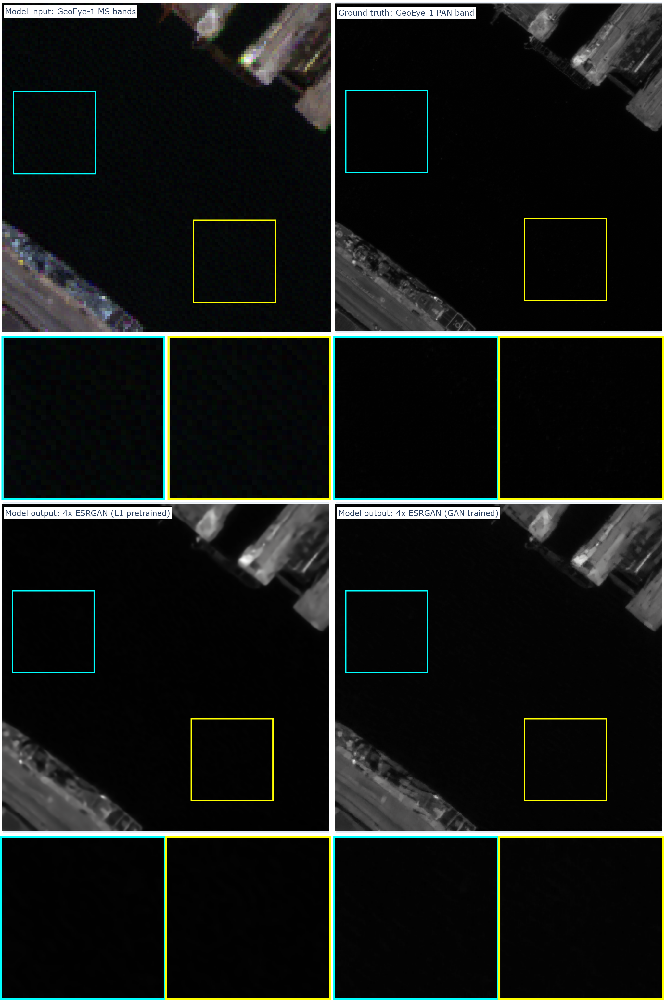

In [9]:
def concatenate_pngs(png_paths, horizontal_vertical='horizontal', 
                     margin=0, write_to_disk=False, write_path=None):
    pngs = []
    for png_path in png_paths:
        pngs.append(Image.open(png_path))
    
    widths, heights = zip(*(i.size for i in pngs))
    if horizontal_vertical == 'horizontal':
        new_width = sum(widths) + margin * len(pngs) - margin
        new_height = max(heights)
    elif horizontal_vertical == 'vertical':
        new_width = max(widths)
        new_height = sum(heights) + margin * len(pngs) - margin
    
    new_png = Image.new('RGBA', size=(new_width, new_height), color=(255,255,255,255))
    
    if horizontal_vertical == 'horizontal':
        x_offset = 0
        for png in pngs:
            new_png.paste(png, (x_offset,0))
            x_offset += png.size[0] + margin
    elif horizontal_vertical == 'vertical':
        y_offset = 0
        for png in pngs:
            new_png.paste(png, (0,y_offset))
            y_offset += png.size[1] + margin
        
    if write_to_disk:
        new_png.save(write_path, 'png')
    return new_png

ms_and_pan = [pathlib.Path(RESULTS_DIR).joinpath(img_ms), pathlib.Path(RESULTS_DIR).joinpath(img_pan)] 
pre_and_gan = [pathlib.Path(RESULTS_DIR).joinpath(img_sr_pre), pathlib.Path(RESULTS_DIR).joinpath(img_sr_gan)]

concatenate_pngs(ms_and_pan, horizontal_vertical='horizontal', margin=2, 
                 write_to_disk=True, 
                 write_path=pathlib.Path(RESULTS_DIR).joinpath(img_pan[:5] + '-ms-pan.png'))
concatenate_pngs(pre_and_gan, horizontal_vertical='horizontal', margin=2, 
                 write_to_disk=True, 
                 write_path=pathlib.Path(RESULTS_DIR).joinpath(img_pan[:5] + '-sr-pre-gan.png'))

concatenate_pngs([pathlib.Path(RESULTS_DIR).joinpath(img_pan[:5] + '-ms-pan.png'), 
                  pathlib.Path(RESULTS_DIR).joinpath(img_pan[:5] + '-sr-pre-gan.png')], 
                 horizontal_vertical='vertical', margin=2, 
                 write_to_disk=True, 
                 write_path=pathlib.Path(RESULTS_DIR).joinpath(img_pan[:5] + '-ms-pan-sr-pre-gan.png'))